<a href="https://colab.research.google.com/github/bd1ng/mechinterp/blob/main/mechinterp_sae_demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# AIPI 590 - XAI | Assignment #06

### Mechanistic Interpretability
(A first step toward) mechanistic interpretability through the training of a small-scale sparse autoencoder (144 photos at 64x64px) to identify features within the set of images and mapping neurons to interpretable concepts. Includes a set of visual representations for each feature by identifying images that have the highest activation values.

### Bochu Ding

[![Open In Collab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/bd1ng/mechinterp/blob/main/mechinterp_sae_demo.ipynb)

# 1. Literature

**Paper Referenced**: [Daujotas et al. "Interpreting and Steering Features in Images"](https://www.lesswrong.com/posts/Quqekpvx8BGMMcaem/interpreting-and-steering-features-in-images)

The mechanistic interpretability technique I chose is training a sparse autoencoder for feature identification and, ideally, to isolate unique interpretable concepts that individual neurons are "looking for."

My plan for this small-scale experiment is to train a sparse autoencoder a small number of photos (144) at low fidelity (64 x 64px). I will adjust parameters like learning rate, l1, and number of epochs to ensure proper model training. I will evaluate this by assessing the loss rate as well as the reconstructed photos. The latter should retain key features of each image, but be more abstract and generalized (read: blurry). Finally, I will attempt to map features onto interpretable concepts by identifying the images for which the activation value of a given feature is the highest.

I chose this method because I would like to apply it to a larger project of detecting bias in generative visual media.  I am curious to see if SAEs can be used to identify certain racial, ethnic, and gender biases in algorithm-generated images.


# 2. Sparse Autoencoder Model

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Import Packages (Generated by ChatGPT o1 on Feb 13 at 3:12p)
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing import image_dataset_from_directory
import os
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

In [ ]:
# Identify Dataset
set = "/content/drive/My Drive/SAE_set"

In [ ]:
# Load Images (Generated by ChatGPT o1 on Feb 13 at 3:12p)

# Define image size & batch size
img_size = (64, 64)
batch_size = 8 # Adjusted based on ChatGPT 4o explanation on Feb 13 at 3:15p

# Load dataset
dataset = tf.keras.preprocessing.image_dataset_from_directory(
    set,
    label_mode=None,
    image_size=img_size,
    batch_size=batch_size,
)

# Normalize images to [0,1] range
def normalize(image):
    image = tf.cast(image, tf.float32) / 255.0
    return image

# Form dataset
dataset = dataset.map(lambda x: normalize(x))

Found 144 files.


In [ ]:
# Hyperparameters (Generated by ChatGPT o1 on Feb 13 at 3:12p)
# Define input_shape
input_shape = (64, 64, 3) # Adjusted from o1 output based on 4o explanation on Feb 13 at 3:26p. Adjusted for 3 (RGB) dimensions.

encoding_dim = 512  # Increased dimensions 64 -> 128 -> 512 to improve feature identification with help of 4o on Feb 13 at 4:32p
l1_reg = 1e-5

In [ ]:
# Autoencoder Training (Generated by ChatGPT o1 on Feb 13 at 3:12p, adjusted by 4o at 3:31 to account for change in input shape)

# Encoder
inputs = keras.Input(shape=input_shape)
x = layers.Conv2D(64, (3,3), activation='relu', padding='same')(inputs)  # Increased decoder power to improve feature identification with help of 4o on Feb 13 at 4:32p
x = layers.BatchNormalization()(x) # Normalization to improve performance with help of 4o on Feb 13 at 4:49p
x = layers.MaxPooling2D((2,2), padding='same')(x)
x = layers.Conv2D(32, (3,3), activation='relu', padding='same')(x) # Increased decoder power to improve feature identification with help of 4o on Feb 13 at 4:32p
x = layers.BatchNormalization()(x) # Normalization to improve performance with help of 4o on Feb 13 at 4:49p
x = layers.MaxPooling2D((2,2), padding='same')(x)

# Flatten and Dense with L1 activity regularization
x = layers.Flatten()(x)
encoded = layers.Dense(encoding_dim,
                       activation='relu',
                       activity_regularizer=keras.regularizers.l1(l1_reg))(x)

# Decoder
x = layers.Dense(1024, activation='relu')(encoded)  # Expand latent details to improve performance with help of 4o on Feb 13 at 4:59p
x = layers.Dense(16 * (64//4) * (64//4), activation='relu')(encoded)  # Adjusted for RGB by 4o
x = layers.Reshape((64//4, 64//4, 16))(x)
x = layers.Conv2DTranspose(16, (3,3), strides=2, activation='relu', padding='same')(x)
x = layers.BatchNormalization()(x) # Normalization to improve performance with help of 4o on Feb 13 at 4:49p
x = layers.Conv2DTranspose(32, (3,3), strides=2, activation='relu', padding='same')(x)
x = layers.BatchNormalization()(x) # Normalization to improve performance with help of 4o on Feb 13 at 4:49p

# Output layer: Change to 3 channels (RGB)
decoded = layers.Conv2D(3, (3,3), activation='sigmoid', padding='same')(x)

# Build Autoencoder
autoencoder = keras.Model(inputs, decoded)
autoencoder.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4), loss='mae') # Updated learning rate on Feb 13 at 4:29p based on troubleshooting with the help of GPT4o.
autoencoder.summary()

Model: "functional_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_10 (InputLayer)          │ (None, 64, 64, 3)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_30 (Conv2D)                   │ (None, 64, 64, 64)          │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_12               │ (None, 64, 64, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_20 (MaxPooling2D)      │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_31 (Conv2D)                   │ (None, 32, 32, 32)          │          18,464 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_13               │ (None, 32, 32, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_21 (MaxPooling2D)      │ (None, 16, 16, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_10 (Flatten)                 │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_22 (Dense)                     │ (None, 512)                 │       4,194,816 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_24 (Dense)                     │ (None, 4096)                │       2,101,248 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape_10 (Reshape)                 │ (None, 16, 16, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_20                  │ (None, 32, 32, 16)          │           2,320 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_14               │ (None, 32, 32, 16)          │              64 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_21                  │ (None, 64, 64, 32)          │           4,640 │
│ (Conv2DTranspose)                    │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_15               │ (None, 64, 64, 32)          │             128 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_32 (Conv2D)                   │ (None, 64, 64, 3)           │             867 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,324,723 (24.13 MB)

 Trainable params: 6,324,435 (24.13 MB)

 Non-trainable params: 288 (1.12 KB)

In [ ]:
# Manually Split Dataset (Generated by ChatGPT 4o on Feb 13 at 3:49p, adjusted via help of o1 at 3:58p for dynamic batching)

total_batches = len(dataset)
val_batches = int(0.1 * total_batches)  # 10% for validation

val_dataset = dataset.take(val_batches)
train_dataset = dataset.skip(val_batches)

# Normalize function (Removed for now based on troubleshooting by 4o at 4:20p; retained for future reference)
# def normalize(image):
# return tf.cast(image, tf.float32) #/ 255.0  # Convert to float and scale

# Apply normalization to both train and validation datasets
train_dataset = train_dataset.map(lambda x: (x, x))
val_dataset = val_dataset.map(lambda x: (x, x))

In [ ]:
# Count training batches (Generated by ChatGPT 4o on Feb 13 at 3:49p; Keeping for spotchecking for future reference)
train_count = sum(1 for _ in train_dataset)
val_count = sum(1 for _ in val_dataset)

print("train_dataset has", train_count, "batches")
print("val_dataset has", val_count, "batches")


train_dataset has 17 batches
val_dataset has 1 batches


In [ ]:
# Train Autoencoder (Generated by ChatGPT o1 on Feb 13 at 3:38p, updated on 3:51p and 3:58p)
autoencoder.fit(train_dataset, epochs=100, validation_data = val_dataset)

Epoch 1/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 9s 73ms/step - loss: 0.3496 - val_loss: 0.2801
Epoch 2/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - loss: 0.3123 - val_loss: 0.2834
Epoch 3/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.2969 - val_loss: 0.2873
Epoch 4/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.2869 - val_loss: 0.2891
Epoch 5/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step - loss: 0.2845 - val_loss: 0.2945
Epoch 6/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step - loss: 0.2842 - val_loss: 0.2968
Epoch 7/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - loss: 0.2753 - val_loss: 0.2982
Epoch 8/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 23ms/step - loss: 0.2730 - val_loss: 0.3125
Epoch 9/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 25ms/step - loss: 0.2645 - val_loss: 0.2880
Epoch 10/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.2532 - val_loss: 0.2956
Epoch 11/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.2399 - val_loss: 0.2996
Epoch 12/100
17/17 ━━━━━━━━━━━━━━━━━━━━ 1s 26ms/step

In [ ]:
# Reconstruct Dataset (Generated by ChatGPT o1 on Feb 13 at 3:38p)
reconstructed_images = autoencoder.predict(dataset)

18/18 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step


Total images loaded: 144
5/5 ━━━━━━━━━━━━━━━━━━━━ 1s 156ms/step


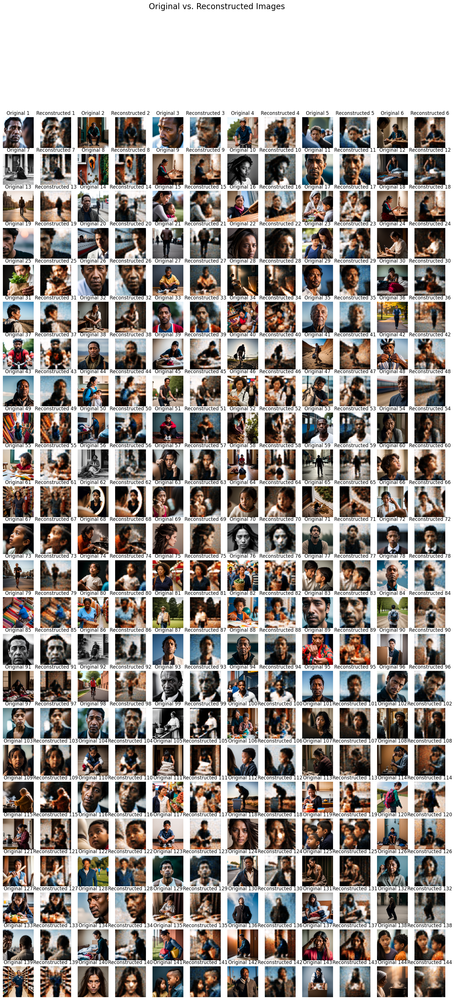

In [ ]:
# Display reconstructed images (Generated by ChatGPT 4o on Feb 13 at 4:40p, updated via troubleshoot at 4:45p)

# Step 1: Collect 144 images from multiple batches
all_images = []
for batch in dataset.take(18):  # Assuming batch_size=8, take 18 batches (8*18 = 144)
    all_images.append(batch.numpy())

# Convert to a single NumPy array
all_images = np.concatenate(all_images, axis=0)

print("Total images loaded:", all_images.shape[0])  # Should print: Total images loaded: 144

# Step 2: Pass the images through the autoencoder for reconstruction
reconstructed_images = autoencoder.predict(all_images[:144])  # Get 144 reconstructions

# Step 3: Display both Original and Reconstructed Images
num_images = 144  # Display all images
rows = 12  # Number of rows
cols = 12  # Number of columns

plt.figure(figsize=(20, 40))  # Large figure for better visualization

for i in range(num_images):
    # Original Image
    plt.subplot(rows * 2, cols, 2 * i + 1)  # Odd positions: Original
    plt.imshow(all_images[i])
    plt.axis("off")
    plt.title(f"Original {i+1}")

    # Reconstructed Image
    plt.subplot(rows * 2, cols, 2 * i + 2)  # Even positions: Reconstructed
    plt.imshow(reconstructed_images[i])
    plt.axis("off")
    plt.title(f"Reconstructed {i+1}")

plt.suptitle("Original vs. Reconstructed Images", fontsize=20)
plt.show()



**Interpretation:** This took many, many rounds of/attempts at training to get it "right" for feature extraction. From the reconstructed photos, we can infer that the model has learned certain high-level feature representations, as the blurrier reconstructed photos retain key image features while discarding finer-grain details. Previous versions resulted in completely dark squares, brown and foggy representations, or a combination of the above.

In [ ]:
# Saving Reconstructed Images (Generated by ChatGPT o1 on Feb 13 at 3:38p)

save_folder = "/content/drive/My Drive/SAE_output"
os.makedirs(save_folder, exist_ok=True)

# reconstructed_images is a numpy array with values in [0,1]
for i, img_array in enumerate(reconstructed_images):
    # Convert float32 [0,1] to uint8 [0,255]
    img_uint8 = (img_array * 255).astype(np.uint8)
    # Create a PIL Image from array
    img_pil = Image.fromarray(img_uint8)
    # Save the image
    img_pil.save(os.path.join(save_folder, f"reconstructed_{i}.png"))


In [ ]:
# Image Association with NN Features (Generated by ChatGPT o1 on Feb 13 at 3:38p)

# Encoder-Only Model
x = layers.Flatten()(x)  # Ensure a 1D feature vector before Dense, suggested by 4o on Feb 13 at 5:42p
encoded = layers.Dense(encoding_dim, activation='relu',
                       activity_regularizer=keras.regularizers.l1(l1_reg))(x)
encoder_model = keras.Model(inputs=autoencoder.input, outputs=encoded)


# Pass Images through Encoder
all_latents = []
for batch in dataset:  # No shuffle, so order is fixed
    latent_batch = encoder_model.predict(batch)
    all_latents.append(latent_batch)

all_latents = np.concatenate(all_latents, axis=0)  # shape: (N, encoding_dim)
print("all_latents:", all_latents.shape)

train_images_list = []
for batch in dataset:  # same dataset, same order, no shuffle
    train_images_list.append(batch.numpy())  # each batch is shape (batch_size, H, W, C)

train_images = np.concatenate(train_images_list, axis=0)  # shape: (N, H, W, C)
print("train_images:", train_images.shape)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 888ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
all_latents: (144, 64)
train_images: (144, 64, 64, 3)


Final image count: 144


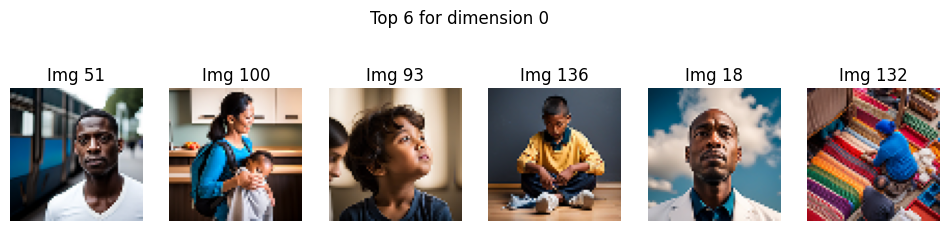

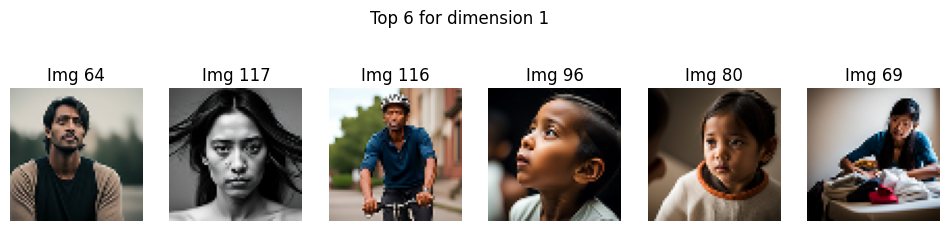

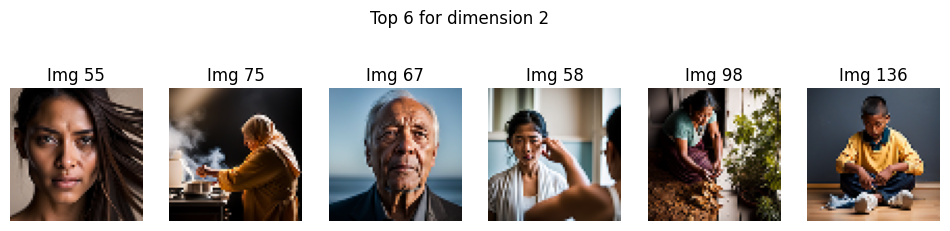

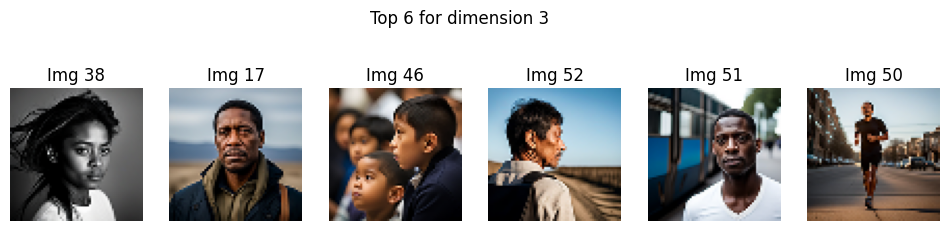

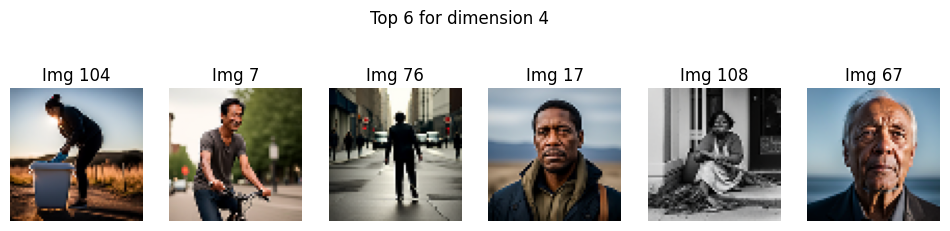

...

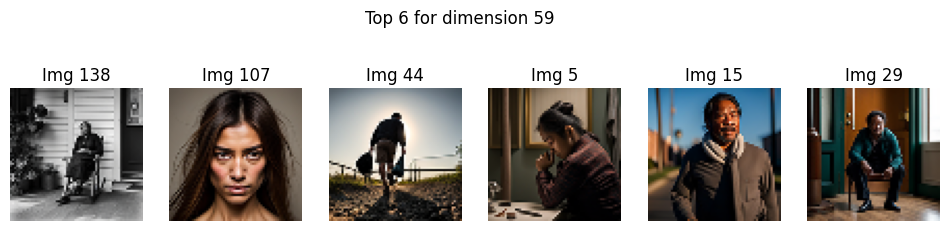

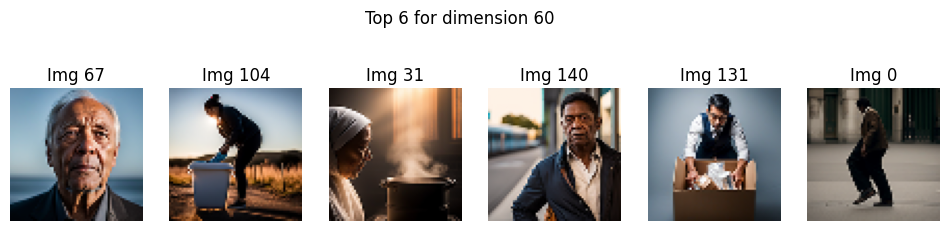

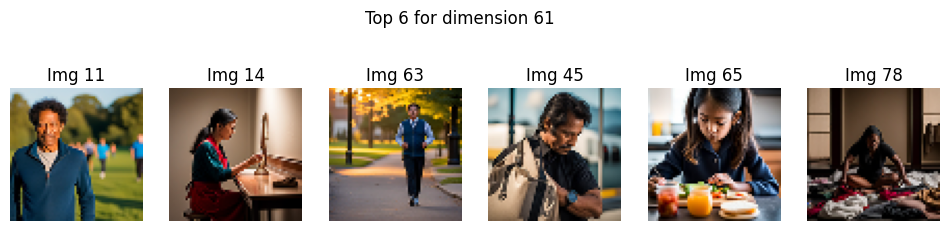

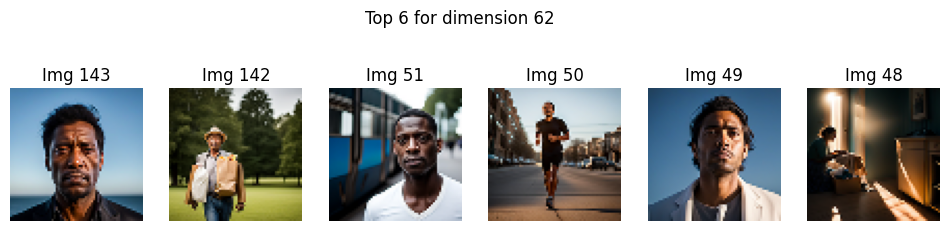

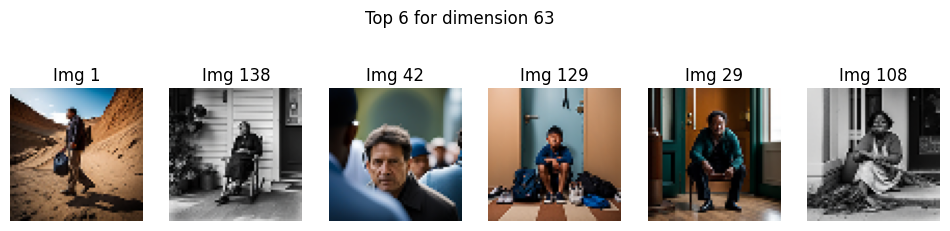

In [ ]:
# Image Association with NN Features Visualization (Generated by 4o on Feb 13 at 5:42p)

num_images = min(train_images.shape[0], all_latents.shape[0])
train_images = train_images[:num_images]
all_latents  = all_latents[:num_images]

print("Final image count:", num_images)

encoding_dim = all_latents.shape[1]
num_top_images = 6

for dim_idx in range(encoding_dim):
    # 1) Extract activation values for this dimension
    dim_values = all_latents[:, dim_idx]  # shape: (num_images,)

    # 2) Get descending sorted indices
    sorted_indices = np.argsort(dim_values)[::-1]  # largest to smallest
    # 3) Select only valid indices
    top_indices = [idx for idx in sorted_indices[:num_top_images] if idx < train_images.shape[0]]

    # Ensure we actually have enough images to display
    if len(top_indices) == 0:
        print(f"Skipping dimension {dim_idx}, no valid indices found.")
        continue  # Skip this feature if there are no valid images

    # 4) Plot them
    plt.figure(figsize=(12, 3))
    for i, img_idx in enumerate(top_indices):
        plt.subplot(1, num_top_images, i+1)
        plt.imshow(train_images[img_idx])
        plt.axis('off')
        plt.title(f"Img {img_idx}")
    plt.suptitle(f"Top {num_top_images} for dimension {dim_idx}")
    plt.show()


**Interpretation:** Given the number and resolution of the images, the features represented are not the clearest in interpretability.  However, even so, there is some evidence of the model honing on specific characteristics. For example, refer to dimension 28, where the model is "looking for" a certain pose. (Of course, a caveat to this observation being that this might be confirmation bias.)

# 3. Discussion

### **Deviations and Results**
Relative to the reference paper, this project was trained on a lot less data, in terms of number of photos, their resolution, and the number of features. This resulted in features that were far less intuitively interpretable by humans. I suspect that these results will improve by scaling up the robustness of the model and its inputs.

### **Challenges and Learnings**
This project showed me the intricacies of model-traning. It took many tries and adjustments to parameters to produce a neural network that achieved acceptable abstractions of the dataset. I toggled, at any given point, a mix of the learning rate, l1, epochs, batches, and encoding dimensions. I am curious (and worried) about what this will look like when I attempt to scale the model up.

### **Next Steps**
An intuitive next step that I didn't get to in this exercise is feature visualizaiton. Particularly in the case of dimension/feature 28 (see note above), where there seems to be an interpretable concept, feature visualization may help confirm if the model is truly capturing said concept. This will also elucidate how neurons might be "looking for" different elements at different levels of abstraction, such as edges v.s. specific shapes or visual elements.
